In [1]:
import os
import pandas as pd

pdb_sugar_files = os.listdir("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/pdb_res_higher_than_2_sugars")
colvar_files = os.listdir("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/colvar_ht2_sugars")

sugar_files_df = pd.DataFrame({"sugar_file_names": pdb_sugar_files})
colvar_files_df = pd.DataFrame({"colvar_file_names": colvar_files})

In [2]:
#Tira os arquivos de backup

# Filtrar e excluir os valores que começam com "bck"
nobck_colvar_df = colvar_files_df[~colvar_files_df['colvar_file_names'].str.startswith('bck')]

In [3]:
# Filtrar nobck_colvar_df para manter somente os valores que são substrings dos valores de sugar_files_df
def is_substring_in_any(value, substrings):
    return any(value in substring for substring in substrings)

# Aplicar a função para filtrar as linhas
filtered_df = nobck_colvar_df[nobck_colvar_df['colvar_file_names'].apply(lambda x: is_substring_in_any(x, sugar_files_df['sugar_file_names']))]

In [4]:
#Extrair dados colvar
from tqdm import tqdm

# Criar os DataFrames vazios com as colunas especificadas
piranose_df = pd.DataFrame(columns=['sugar', 'time', 'puck.qx', 'puck.qy', 'puck.qz', 'puck.phi', 'puck.theta', 'puck.amplitude'])

furanose_df = pd.DataFrame(columns=['sugar', 'time', 'puck.phs', 'puck.amp', 'puck.Zx', 'puck.Zy'])

# Caminho para o arquivo .colvar
#file_path = "/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/colvar/6zho_GLC_4663"

def read_colvar(file_path):
    global piranose_df
    global furanose_df

    # Abrir o arquivo e ler as linhas
    with open(file_path, 'r') as file:
        lines = file.readlines()

    # Encontrar a linha com os nomes das colunas (depois de "#! FIELDS")
    fields_line = next(line for line in lines if line.startswith('#! FIELDS'))

    # Extrair nomes das colunas (remover "#! FIELDS " e dividir os nomes das colunas)
    column_names = fields_line.strip().lstrip('#! FIELDS').strip().split()

    # Ler o restante do arquivo usando pandas
    data = pd.read_csv(file_path, delim_whitespace=True, comment='#', header=None, skiprows=1, names=column_names)

    data['sugar'] = file_path.split('colvar/', 1)[-1]

    # Reordenar as colunas para colocar 'sugar' como a primeira
    cols = ['sugar'] + [col for col in data.columns if col != 'sugar']
    data = data[cols]

    # Adicionar no DF geral
    if(len(data.columns) == 8):
        #Piranoses
        piranose_df = pd.concat([piranose_df, data], ignore_index=True)
    elif(len(data.columns) == 6):
        #Furanoses
        furanose_df = pd.concat([furanose_df, data], ignore_index=True)

# Iterar sobre os nomes dos arquivos e processá-los com uma barra de progresso
for file_name in tqdm(filtered_df['colvar_file_names']):
    read_colvar("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/colvar_ht2_sugars/" + file_name)



  0%|          | 0/83358 [00:00<?, ?it/s]/tmp/ipykernel_3437375/2057967476.py:27: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(file_path, delim_whitespace=True, comment='#', header=None, skiprows=1, names=column_names)
/tmp/ipykernel_3437375/2057967476.py:38: FutureWarning: The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.
  piranose_df = pd.concat([piranose_df, data], ignore_index=True)
  0%|          | 1/83358 [00:00<3:44:21,  6.19it/s]/tmp/ipykernel_3437375/2057967476.py:27: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  data = pd.read_csv(file_pa

In [5]:
#Tirar o caminho dos nomes
piranose_df['sugar'] = piranose_df['sugar'].str.split('sugars/').str[-1]
furanose_df['sugar'] = furanose_df['sugar'].str.split('sugars/').str[-1]

In [6]:
furanose_df.to_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/ht2_furanoses.csv")

In [8]:
#No duplicates
piranose_df = piranose_df.drop_duplicates()

In [10]:
#To degrees
import numpy as np

piranose_df['puck.phi_graus'] = np.degrees(piranose_df['puck.phi'])
piranose_df['puck.theta_graus'] = np.degrees(piranose_df['puck.theta'])


#TO .colvar_files

piranose_df.to_csv("/home/douglas/carboanalysis/carboanalysis/pdb/dataframes/puckering/ht2_piranoses_degrees.csv", header=None)

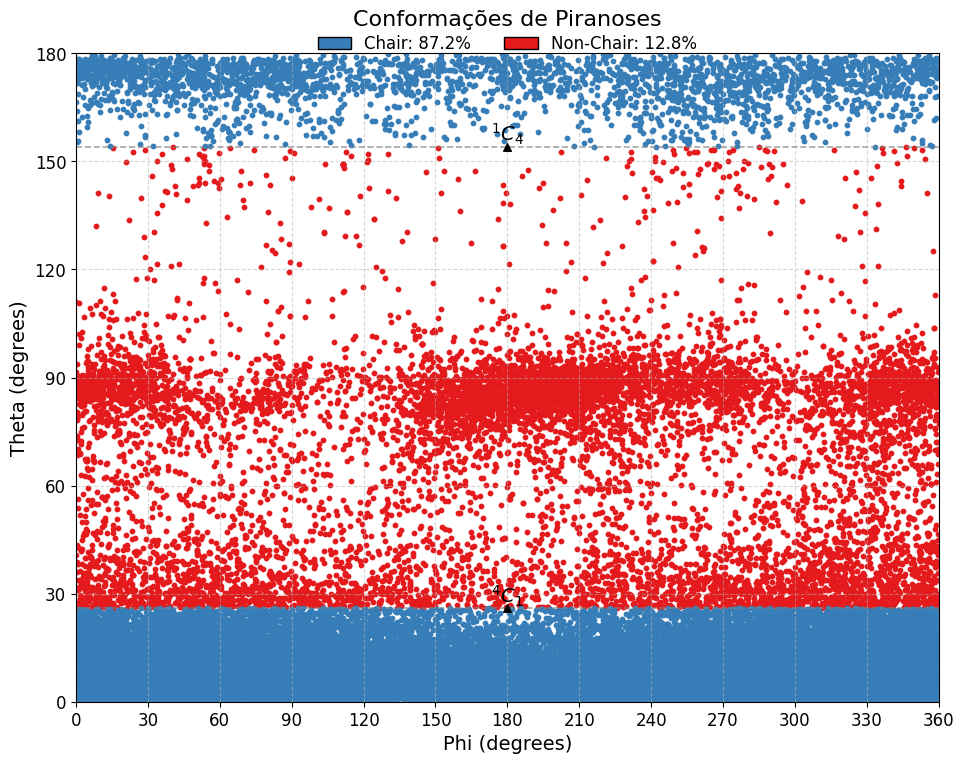

In [14]:
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Patch

# Converter as colunas 'puck.theta_graus' e 'puck.phi_graus' para numéricas
piranose_df['puck.theta_graus'] = pd.to_numeric(piranose_df['puck.theta_graus'], errors='coerce')
piranose_df['puck.phi_graus'] = pd.to_numeric(piranose_df['puck.phi_graus'], errors='coerce')

# Verificar se piranose_df está carregado
try:
    piranose_df
except NameError:
    raise NameError("O DataFrame 'piranose_df' não foi definido. Por favor, carregue-o antes de executar o código.")

# Coordenadas e labels
coordinates = [
    (180, 26, r"$^{4}C_{1}$"),
    (180, 154, r"$^{1}C_{4}$")
]

# Cores para os pontos
default_color = '#377eb8'  # Azul (Chair)
highlight_color = '#e41a1c'  # Vermelho (Non-Chair)

# Criar uma figura única
fig, ax = plt.subplots(figsize=(10, 8))

# Filtrar os dados do DataFrame
highlight_condition = (piranose_df['puck.theta_graus'] > 26) & (piranose_df['puck.theta_graus'] < 154)

# Pontos destacados (Non-Chair)
ax.scatter(
    piranose_df.loc[highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[highlight_condition, 'puck.theta_graus'], 
    color=highlight_color,  # Vermelho
    s=10,  # Tamanho dos pontos (aumentado para melhor visualização)
    label='Non-Chair'
)

# Pontos padrão (Chair)
ax.scatter(
    piranose_df.loc[~highlight_condition, 'puck.phi_graus'], 
    piranose_df.loc[~highlight_condition, 'puck.theta_graus'], 
    color=default_color,  # Azul
    s=10,  # Tamanho dos pontos
    label='Chair'
)

# Adicionar as coordenadas específicas com rótulos
for x, y, label in coordinates:
    ax.axhline(
        y=y, 
        color='gray', 
        linestyle='--', 
        linewidth=1.2, 
        alpha=0.7, 
        zorder=1
    )  # Linha horizontal
    ax.scatter(x, y, color='black', s=30, marker='^', zorder=10)  # Ponto marcado
    ax.text(
        x, y, 
        label,
        fontsize=14,  # Aumentar o tamanho da fonte
        ha='center',
        va='bottom',
        color='black',
        zorder=10
    )

# Configurações do gráfico
ax.set_xlim([0, 360])  # Limites do eixo x
ax.set_ylim([0, 180])  # Limites do eixo y
ax.set_xlabel('Phi (degrees)', fontsize=14)  # Rótulo do eixo x
ax.set_ylabel('Theta (degrees)', fontsize=14)  # Rótulo do eixo y
ax.set_title('Conformações de Piranoses', fontsize=16, pad=20)  # Título com maior espaçamento

# Definir os valores dos eixos com intervalo de 30
ax.set_xticks(range(0, 361, 30))  # Eixo x de 0 a 360 com intervalo de 30
ax.set_yticks(range(0, 181, 30))  # Eixo y de 0 a 180 com intervalo de 30
ax.tick_params(axis='both', labelsize=12)  # Ajustar tamanho das labels dos eixos
ax.grid(True, linestyle='--', alpha=0.5)  # Adicionar grade para melhor visualização

# Cálculo das porcentagens
total_points = len(piranose_df)
chair_points = len(piranose_df.loc[~highlight_condition])
non_chair_points = len(piranose_df.loc[highlight_condition])

chair_percentage = (chair_points / total_points) * 100
non_chair_percentage = (non_chair_points / total_points) * 100

# Adicionar a legenda no topo central
legend_elements = [
    Patch(facecolor=default_color, edgecolor='black', label=f'Chair: {chair_percentage:.1f}%'),
    Patch(facecolor=highlight_color, edgecolor='black', label=f'Non-Chair: {non_chair_percentage:.1f}%')
]
ax.legend(
    handles=legend_elements,
    loc='upper center',
    bbox_to_anchor=(0.5, 1.052),
    fontsize=12,
    frameon=False,
    ncol=2  # Organiza a legenda em duas colunas
)

plt.tight_layout(pad=2.0)  # Ajuste de padding para evitar sobreposição
plt.show()